In [1]:
import pandas as pd
import numpy as np
from tqdm import tqdm
from sklearn.decomposition import PCA
from warnings import filterwarnings
from matplotlib import rc
rc('font', family='AppleGothic') 
filterwarnings('ignore')

In [2]:
industry=pd.read_pickle('./Data/industry.pkl')
industry=industry.loc[(industry.index.month==3)|
             (industry.index.month==5)|
             (industry.index.month==8)|
             (industry.index.month==11)]
industry=industry.T
industry.index=industry.index.swaplevel(0,1)
industry

,,2000-05-31,2000-08-31,2000-11-30,2001-03-31,2001-05-31,2001-08-31,2001-11-30,2002-03-31,2002-05-31,2002-08-31,...,2020-08-31,2020-11-30,2021-03-31,2021-05-31,2021-08-31,2021-11-30,2022-03-31,2022-05-31,2022-08-31,2022-11-30
Symbol Name,Symbol,,,,,,,,,,,,,,,,,,,,,
삼성전자,A005930,반도체,반도체,반도체,반도체,반도체,반도체,반도체,반도체,반도체,반도체,...,하드웨어,하드웨어,하드웨어,하드웨어,하드웨어,하드웨어,하드웨어,하드웨어,하드웨어,하드웨어
LG에너지솔루션,A373220,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,하드웨어,하드웨어,하드웨어,하드웨어
삼성바이오로직스,A207940,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,제약 및 바이오,제약 및 바이오,제약 및 바이오,제약 및 바이오,제약 및 바이오,제약 및 바이오,제약 및 바이오,제약 및 바이오,제약 및 바이오,제약 및 바이오
SK하이닉스,A000660,반도체,반도체,반도체,반도체,반도체,반도체,반도체,반도체,반도체,반도체,...,반도체,반도체,반도체,반도체,반도체,반도체,반도체,반도체,반도체,반도체
LG화학,A051910,NaN,NaN,NaN,NaN,소재,소재,소재,소재,소재,소재,...,소재,소재,소재,소재,소재,소재,소재,소재,소재,소재
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
평산차업 KDR,A950010,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,음식료 및 담배,음식료 및 담배,음식료 및 담배,음식료 및 담배,음식료 및 담배,음식료 및 담배,음식료 및 담배,음식료 및 담배,음식료 및 담배,음식료 및 담배
네프로아이티,A950030,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,소프트웨어,소프트웨어,소프트웨어,소프트웨어,소프트웨어,소프트웨어,소프트웨어,소프트웨어,소프트웨어,소프트웨어
중국고섬,A950070,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,내구 소비재 및 의류,내구 소비재 및 의류,내구 소비재 및 의류,내구 소비재 및 의류,내구 소비재 및 의류,내구 소비재 및 의류,내구 소비재 및 의류,내구 소비재 및 의류,내구 소비재 및 의류,내구 소비재 및 의류


In [3]:
feature_df=pd.read_pickle('./Data/feature.pkl')
feature_df

투자후1분기뒤수익률                                              \
                    2000-05-31 2000-08-31 2000-11-30 2001-03-31 2001-05-31   
Symbol Name Symbol                                                           
삼성전자        A005930  -0.112013  -0.407678   0.283951   0.019231  -0.103774   
LG에너지솔루션    A373220        NaN        NaN        NaN        NaN        NaN   
삼성바이오로직스    A207940        NaN        NaN        NaN        NaN        NaN   
SK하이닉스      A000660   0.153411  -0.663054  -0.538743   0.375589  -0.808752   
LG화학        A051910        NaN        NaN        NaN        NaN  -0.144383   
...                        ...        ...        ...        ...        ...   
평산차업 KDR    A950010        NaN        NaN        NaN        NaN        NaN   
네프로아이티      A950030        NaN        NaN        NaN        NaN        NaN   
중국고섬        A950070        NaN        NaN        NaN        NaN        NaN   
SBI모기지      A950100        NaN        NaN        NaN        NaN        NaN   
SNK         A950180        NaN        NaN        NaN        NaN        NaN   

                                                                            \
                    2001-08-31 2001-11-30 2002-03-31 2002-05-31 2002-08-31   
Symbol Name Symbol                                                           
삼성전자        A005930   0.147368   0.688073  -0.070652  -0.032164   0.169184   
LG에너지솔루션    A373220        NaN        NaN        NaN        NaN        NaN   
삼성바이오로직스    A207940        NaN        NaN        NaN        NaN        NaN   
SK하이닉스      A000660   1.584300  -0.328670  -0.520819  -0.224659  -0.186917   
LG화학        A051910   0.356214   1.013836  -0.086950   0.090225   0.013788   
...                        ...        ...        ...        ...        ...   
평산차업 KDR    A950010        NaN        NaN        NaN        NaN        NaN   
네프로아이티      A950030        NaN        NaN        NaN        NaN        NaN   
중국고섬        A950070        NaN        NaN        NaN        NaN        NaN   
SBI모기지      A950100        NaN        NaN        NaN        NaN        NaN   
SNK         A950180        NaN        NaN        NaN        NaN        NaN   

                     ... FnGuide Industry Group                            \
                     ...             2020-08-31   2020-11-30   2021-03-31   
Symbol Name Symbol   ...                                                    
삼성전자        A005930  ...                   하드웨어         하드웨어         하드웨어   
LG에너지솔루션    A373220  ...                    NaN          NaN          NaN   
삼성바이오로직스    A207940  ...               제약 및 바이오     제약 및 바이오     제약 및 바이오   
SK하이닉스      A000660  ...                    반도체          반도체          반도체   
LG화학        A051910  ...                     소재           소재           소재   
...                  ...                    ...          ...          ...   
평산차업 KDR    A950010  ...               음식료 및 담배     음식료 및 담배     음식료 및 담배   
네프로아이티      A950030  ...                  소프트웨어        소프트웨어        소프트웨어   
중국고섬        A950070  ...            내구 소비재 및 의류  내구 소비재 및 의류  내구 소비재 및 의류   
SBI모기지      A950100  ...                     은행           은행           은행   
SNK         A950180  ...                  소프트웨어        소프트웨어        소프트웨어   

                                                                         \
                      2021-05-31   2021-08-31   2021-11-30   2022-03-31   
Symbol Name Symbol                                                        
삼성전자        A005930         하드웨어         하드웨어         하드웨어         하드웨어   
LG에너지솔루션    A373220          NaN          NaN          NaN         하드웨어   
삼성바이오로직스    A207940     제약 및 바이오     제약 및 바이오     제약 및 바이오     제약 및 바이오   
SK하이닉스      A000660          반도체          반도체          반도체          반도체   
LG화학        A051910           소재           소재           소재           소재   
...                          ...          ...          ...          ...   
평산차업 KDR    A950010     음식료 및 담배     음식료 및 담배     음식료 및 담배     음식료 및 담배   
네프로아이

In [5]:
feature_name=feature_df.columns.get_level_values(0)
time=feature_df.columns.get_level_values(1)

In [6]:
feature_name.unique()

Index(['투자후1분기뒤수익률', '시가총액_z_score', '당기순이익_시가총액_1Q_standardized',
       '지배주주지분_시가총액_1Q_standardized', '매출총이익_시가총액_1Q_standardized',
       '영업이익_시가총액_1Q_standardized', '계속사업이익_시가총액_1Q_standardized',
       '총포괄이익_시가총액_1Q_standardized', '영업활동현금흐름_시가총액_4Q_standardized',
       'ROE영업이익_1Q_standardized', '재무활동으로인한현금흐름2Q_시가총액_stdized',
       '매출액대비영업이익률1Q_stdized', '매출액대비_매출총이익률1Q_stdized',
       '매출액대비_당기순이익률1Q_stdized', '매출액대비_총포괄이익률1Q_stdized',
       '매출액대비_매출총이익률4Q_stdized', '매출액대비_영업이익률4Q_stdized',
       '매출액대비_당기순이익률4Q_stdized', '매출액대비_총포괄이익률4Q_stdized',
       '거래대금_시가총액_3개월_stdized', '직전1분기주식수익률_stdardized',
       '직전1년주식수익률_stdardized', '매출채권회전율_연결_4분기_stdardized',
       '재고자산회전율_연결_4분기_stdardized', '매출액증가_TF', '매출총이익증가_TF', '영업이익증가_TF',
       '당기순이익증가_TF', '총포괄이익증가_TF', '매출액_4Q증가_TF', '매출총이익_4Q증가_TF',
       '영업이익_4Q증가_TF', '당기순이익_4Q증가_TF', '총포괄이익_4Q증가_TF',
       '매출액대비_매출총이익률4Q_stdized_4Q증가_TF', '매출액대비_영업이익률4Q_stdized_4Q증가_TF',
       '매출액대비_당기순이익률4Q_stdized_4Q증가_TF',

In [7]:
feature_df['직전1년주식수익률_stdardized']

,,2000-05-31,2000-08-31,2000-11-30,2001-03-31,2001-05-31,2001-08-31,2001-11-30,2002-03-31,2002-05-31,2002-08-31,...,2020-08-31,2020-11-30,2021-03-31,2021-05-31,2021-08-31,2021-11-30,2022-03-31,2022-05-31,2022-08-31,2022-11-30
Symbol Name,Symbol,,,,,,,,,,,,,,,,,,,,,
삼성전자,A005930,NaN,NaN,NaN,NaN,-0.386396,-0.04221,0.517353,0.639567,1.094646,1.109489,...,0.232418,0.256702,0.005811,0.190251,0.175150,0.079503,-0.372662,-0.102341,-0.000790,0.125482
LG에너지솔루션,A373220,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
삼성바이오로직스,A207940,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.839072,1.104512,-0.190755,-0.150602,-0.121066,0.204541,0.327182,0.394465,0.317980,0.481467
SK하이닉스,A000660,NaN,NaN,NaN,NaN,-1.969587,-3.00000,-1.968015,-1.310273,-2.563101,-0.546703,...,-0.207960,0.058940,-0.139121,0.149272,0.171668,0.278091,-0.266657,-0.062036,0.374228,-0.257178
LG화학,A051910,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.536042,1.850852,...,1.359315,1.658136,0.920523,0.798638,-0.539364,-0.383064,-1.043354,-0.513937,0.185563,0.614683
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
평산차업 KDR,A950010,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
네프로아이티,A950030,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
중국고섬,A950070,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [8]:
feature_name_stdized=['시가총액_z_score', '당기순이익_시가총액_1Q_standardized',
       '지배주주지분_시가총액_1Q_standardized', '매출총이익_시가총액_1Q_standardized',
       '영업이익_시가총액_1Q_standardized', '계속사업이익_시가총액_1Q_standardized',
       '총포괄이익_시가총액_1Q_standardized', '영업활동현금흐름_시가총액_4Q_standardized',
       'ROE영업이익_1Q_standardized', '재무활동으로인한현금흐름2Q_시가총액_stdized',
       '매출액대비영업이익률1Q_stdized', '매출액대비_매출총이익률1Q_stdized',
       '매출액대비_당기순이익률1Q_stdized', '매출액대비_총포괄이익률1Q_stdized',
       '매출액대비_매출총이익률4Q_stdized', '매출액대비_영업이익률4Q_stdized',
       '매출액대비_당기순이익률4Q_stdized', '매출액대비_총포괄이익률4Q_stdized',
       '거래대금_시가총액_3개월_stdized', '직전1분기주식수익률_stdardized',
       '직전1년주식수익률_stdardized', '매출채권회전율_연결_4분기_stdardized',
       '재고자산회전율_연결_4분기_stdardized']
feature_name_bool=['매출액증가_TF', '매출총이익증가_TF', '영업이익증가_TF',
       '당기순이익증가_TF', '총포괄이익증가_TF', '매출액_4Q증가_TF', '매출총이익_4Q증가_TF',
       '영업이익_4Q증가_TF', '당기순이익_4Q증가_TF', '총포괄이익_4Q증가_TF',
       '매출액대비_매출총이익률4Q_stdized_4Q증가_TF', '매출액대비_영업이익률4Q_stdized_4Q증가_TF',
       '매출액대비_당기순이익률4Q_stdized_4Q증가_TF', '매출액대비_총포괄이익률4Q_stdized_4Q증가_TF',
       'CB보유TF', 'BW보유TF', '자본금_12분기전대비증가_TF', '영업이익_흑자TF', '계속사업이익_흑자TF',
       '당기순이익_흑자TF', '총포괄이익_흑자TF']

In [9]:
industry_array=industry.values.flatten()
industry_array=industry_array[~pd.isna(industry_array)]
industry_array=pd.Series(industry_array).unique()
industry_list=list(industry_array)

In [10]:
industry_name=industry_array[0]
#인더스트리에대한 루프

basket=[]
for industry_name in industry_list:
    
    industry_FeatureName_list=[]
    for feature_name_stdized_th in feature_name_stdized:
        industry_FeatureName_list.append(feature_df[feature_name_stdized_th][industry==industry_name])
        
    industry_feature_df=pd.concat(industry_FeatureName_list,axis=1,keys=feature_name_stdized)
    basket.append(industry_feature_df)
    
ALLindustry_N_feature_df=pd.concat(basket,axis=1,keys=industry_list)
ALLindustry_N_feature_df

반도체                                              \
                    시가총액_z_score                                               
                      2000-05-31 2000-08-31 2000-11-30 2001-03-31 2001-05-31   
Symbol Name Symbol                                                             
삼성전자        A005930          3.0        3.0   3.000000   3.000000   3.000000   
LG에너지솔루션    A373220          NaN        NaN        NaN        NaN        NaN   
삼성바이오로직스    A207940          NaN        NaN        NaN        NaN        NaN   
SK하이닉스      A000660          3.0        3.0   2.046561   0.853419   1.120679   
LG화학        A051910          NaN        NaN        NaN        NaN        NaN   
...                          ...        ...        ...        ...        ...   
평산차업 KDR    A950010          NaN        NaN        NaN        NaN        NaN   
네프로아이티      A950030          NaN        NaN        NaN        NaN        NaN   
중국고섬        A950070          NaN        NaN        NaN        NaN        NaN   
SBI모기지      A950100          NaN        NaN        NaN        NaN        NaN   
SNK         A950180          NaN        NaN        NaN        NaN        NaN   

                                                                            \
                                                                             
                    2001-08-31 2001-11-30 2002-03-31 2002-05-31 2002-08-31   
Symbol Name Symbol                                                           
삼성전자        A005930   3.000000    3.00000   3.000000   3.000000    3.00000   
LG에너지솔루션    A373220        NaN        NaN        NaN        NaN        NaN   
삼성바이오로직스    A207940        NaN        NaN        NaN        NaN        NaN   
SK하이닉스      A000660   0.409631    1.13088   0.470226   0.179282    1.23387   
LG화학        A051910        NaN        NaN        NaN        NaN        NaN   
...                        ...        ...        ...        ...        ...   
평산차업 KDR    A950010        NaN        NaN        NaN        NaN        NaN   
네프로아이티      A950030        NaN        NaN        NaN        NaN        NaN   
중국고섬        A950070        NaN        NaN        NaN        NaN        NaN   
SBI모기지      A950100        NaN        NaN        NaN        NaN        NaN   
SNK         A950180        NaN        NaN        NaN        NaN        NaN   

                     ...                       부동산                        \
                     ... 재고자산회전율_연결_4분기_stdardized                         
                     ...                2020-08-31 2020-11-30 2021-03-31   
Symbol Name Symbol   ...                                                   
삼성전자        A005930  ...                       NaN        NaN        NaN   
LG에너지솔루션    A373220  ...                       NaN        NaN        NaN   
삼성바이오로직스    A207940  ...                       NaN        NaN        NaN   
SK하이닉스      A000660  ...                       NaN        NaN        NaN   
LG화학        A051910  ...                       NaN        NaN        NaN   
...                  ...                       ...        ...        ...   
평산차업 KDR    A950010  ...                       NaN        NaN        NaN   
네프로아이티      A950030  ...                       NaN        NaN        NaN   
중국고섬        A950070  ...                       NaN        NaN        NaN   
SBI모기지      A950100  ...                       NaN        NaN        NaN   
SNK         A950180  ...                       NaN        NaN        NaN   

                                                                            \
                                                                             
                    2021-05-31 2021-08-31 2021-11-30 2022-03-31 2022-05-31   
Symbol Name Symbol                                                           
삼성전자        A005930        NaN        NaN        NaN        NaN        NaN   
LG에너지솔루션    A373220        NaN        NaN        NaN        NaN        NaN   
삼성바이오로직스    A207940        NaN        NaN       

In [11]:
ALLindustry_N_feature_df

반도체                                              \
                    시가총액_z_score                                               
                      2000-05-31 2000-08-31 2000-11-30 2001-03-31 2001-05-31   
Symbol Name Symbol                                                             
삼성전자        A005930          3.0        3.0   3.000000   3.000000   3.000000   
LG에너지솔루션    A373220          NaN        NaN        NaN        NaN        NaN   
삼성바이오로직스    A207940          NaN        NaN        NaN        NaN        NaN   
SK하이닉스      A000660          3.0        3.0   2.046561   0.853419   1.120679   
LG화학        A051910          NaN        NaN        NaN        NaN        NaN   
...                          ...        ...        ...        ...        ...   
평산차업 KDR    A950010          NaN        NaN        NaN        NaN        NaN   
네프로아이티      A950030          NaN        NaN        NaN        NaN        NaN   
중국고섬        A950070          NaN        NaN        NaN        NaN        NaN   
SBI모기지      A950100          NaN        NaN        NaN        NaN        NaN   
SNK         A950180          NaN        NaN        NaN        NaN        NaN   

                                                                            \
                                                                             
                    2001-08-31 2001-11-30 2002-03-31 2002-05-31 2002-08-31   
Symbol Name Symbol                                                           
삼성전자        A005930   3.000000    3.00000   3.000000   3.000000    3.00000   
LG에너지솔루션    A373220        NaN        NaN        NaN        NaN        NaN   
삼성바이오로직스    A207940        NaN        NaN        NaN        NaN        NaN   
SK하이닉스      A000660   0.409631    1.13088   0.470226   0.179282    1.23387   
LG화학        A051910        NaN        NaN        NaN        NaN        NaN   
...                        ...        ...        ...        ...        ...   
평산차업 KDR    A950010        NaN        NaN        NaN        NaN        NaN   
네프로아이티      A950030        NaN        NaN        NaN        NaN        NaN   
중국고섬        A950070        NaN        NaN        NaN        NaN        NaN   
SBI모기지      A950100        NaN        NaN        NaN        NaN        NaN   
SNK         A950180        NaN        NaN        NaN        NaN        NaN   

                     ...                       부동산                        \
                     ... 재고자산회전율_연결_4분기_stdardized                         
                     ...                2020-08-31 2020-11-30 2021-03-31   
Symbol Name Symbol   ...                                                   
삼성전자        A005930  ...                       NaN        NaN        NaN   
LG에너지솔루션    A373220  ...                       NaN        NaN        NaN   
삼성바이오로직스    A207940  ...                       NaN        NaN        NaN   
SK하이닉스      A000660  ...                       NaN        NaN        NaN   
LG화학        A051910  ...                       NaN        NaN        NaN   
...                  ...                       ...        ...        ...   
평산차업 KDR    A950010  ...                       NaN        NaN        NaN   
네프로아이티      A950030  ...                       NaN        NaN        NaN   
중국고섬        A950070  ...                       NaN        NaN        NaN   
SBI모기지      A950100  ...                       NaN        NaN        NaN   
SNK         A950180  ...                       NaN        NaN        NaN   

                                                                            \
                                                                             
                    2021-05-31 2021-08-31 2021-11-30 2022-03-31 2022-05-31   
Symbol Name Symbol                                                           
삼성전자        A005930        NaN        NaN        NaN        NaN        NaN   
LG에너지솔루션    A373220        NaN        NaN        NaN        NaN        NaN   
삼성바이오로직스    A207940        NaN        NaN       

In [12]:
# industry_pfl_feature_mean=ALLindustry_N_feature_df['부동산'].T.mean(axis=1).unstack().T.dropna()

# print('바꾸기전 df')
# display(industry_pfl_feature_mean)
# from sklearn.decomposition import PCA

# pca=PCA(n_components=5)

# pca.fit(industry_pfl_feature_mean)
# print('pc순 누적설명력')
# display(pca.explained_variance_ratio_.cumsum())

# print('pc변환결과')
# display(pca.transform(industry_pfl_feature_mean))

# print('pc변환결과 shape')
# display(pca.transform(industry_pfl_feature_mean).shape)



In [23]:
# explained_variance_ratio_list=[]
# pca_result_df_list=[]

# for ind_name in tqdm(industry_list):
#     industry_pfl_feature_mean=ALLindustry_N_feature_df[ind_name].T.mean(axis=1).unstack().T.dropna()
#     pca=PCA(n_components=5)
#     pca.fit(industry_pfl_feature_mean)
    
#     explained_variance_ratio=pd.Series(pca.explained_variance_ratio_)
#     explained_variance_ratio_list.append(explained_variance_ratio)
    
#     pca_result=pca.transform(industry_pfl_feature_mean)
#     pca_result_df=pd.DataFrame(pca_result,columns=['PC'+str(k) for k in range(1,6)],index=industry_pfl_feature_mean.index)
#     pca_result_df_list.append(pca_result_df)
    

# pca_result_by_industry=pd.concat(pca_result_df_list,axis=1,keys=industry_list)
# explained_variance_ratio_df=pd.concat(explained_variance_ratio_list,axis=1,keys=industry_list)

In [24]:
# ALLindustry_N_feature_df[ind_name].T.mean(axis=1)
#T.mean(axis=1).unstack()

In [13]:
explained_variance_ratio_list=[]
pca_result_df_list=[]
pca_components_df_list = []

for ind_name in tqdm(industry_list):
    industry_pfl_feature_mean=ALLindustry_N_feature_df[ind_name].T.mean(axis=1).unstack().T.dropna()
    pca=PCA(n_components=5)
    pca.fit(industry_pfl_feature_mean)


    explained_variance_ratio=pd.Series(pca.explained_variance_ratio_)
    explained_variance_ratio_list.append(explained_variance_ratio)
    
    pca_result=pca.transform(industry_pfl_feature_mean)
    pca_result_df=pd.DataFrame(pca_result,columns=['PC'+str(k) for k in range(1,6)],index=industry_pfl_feature_mean.index)
    pca_result_df_list.append(pca_result_df)
    
    pca_components = pca.components_
    pca_components = pd.DataFrame(pca_components,columns=industry_pfl_feature_mean.columns, index=['PC'+str(k) for k in range(1,6)])
    pca_components_df_list.append(pca_components)
    

pca_result_by_industry=pd.concat(pca_result_df_list,axis=1,keys=industry_list)
explained_variance_ratio_df=pd.concat(explained_variance_ratio_list,axis=1,keys=industry_list)
pca_components_df = pd.concat(pca_components_df_list, axis=1, keys=industry_list)

100%|██████████| 25/25 [00:01<00:00, 12.68it/s]


In [14]:
industry_list[0]

'반도체'

In [15]:
industry_pfl_feature_mean=ALLindustry_N_feature_df['반도체'].T.mean(axis=1).unstack().T.dropna()
pca=PCA(n_components=5)
pca.fit(industry_pfl_feature_mean)

pca_result=pca.transform(industry_pfl_feature_mean)
pca_result_df=pd.DataFrame(pca_result,columns=['PC'+str(k) for k in range(1,6)],index=industry_pfl_feature_mean.index)
#pca_result_df_list.append(pca_result_df)

In [16]:
pca_result.shape

(75, 5)

In [17]:
industry_pfl_feature_mean

,시가총액_z_score,당기순이익_시가총액_1Q_standardized,지배주주지분_시가총액_1Q_standardized,매출총이익_시가총액_1Q_standardized,영업이익_시가총액_1Q_standardized,계속사업이익_시가총액_1Q_standardized,총포괄이익_시가총액_1Q_standardized,영업활동현금흐름_시가총액_4Q_standardized,ROE영업이익_1Q_standardized,재무활동으로인한현금흐름2Q_시가총액_stdized,...,매출액대비_총포괄이익률1Q_stdized,매출액대비_매출총이익률4Q_stdized,매출액대비_영업이익률4Q_stdized,매출액대비_당기순이익률4Q_stdized,매출액대비_총포괄이익률4Q_stdized,거래대금_시가총액_3개월_stdized,직전1분기주식수익률_stdardized,직전1년주식수익률_stdardized,매출채권회전율_연결_4분기_stdardized,재고자산회전율_연결_4분기_stdardized
2004-03-31,0.032643,0.101232,-0.732526,-0.385256,-0.008943,0.093328,0.074499,-0.120252,0.054480,0.111852,...,0.046738,-0.046376,-0.027230,-0.028774,-0.031061,0.034795,0.234012,0.554881,-0.058706,-0.049345
2004-05-31,0.028236,-0.055419,-0.758535,-0.388465,-0.115073,-0.054202,-0.145626,-0.204186,0.068474,0.104454,...,0.046262,-0.059601,-0.025604,0.025662,0.025659,0.241477,0.150140,0.644440,-0.052984,-0.048632
2004-08-31,0.011921,0.052551,-0.643419,-0.355737,-0.039111,0.052551,0.061560,-0.104416,-0.004855,0.036408,...,0.043649,0.006777,-0.025506,0.025734,0.025734,0.049702,-0.382769,0.092347,-0.056378,-0.065292
2004-11-30,0.001510,0.171955,-0.595592,-0.280381,0.118273,0.171955,0.168896,-0.047764,0.052347,0.079846,...,0.045794,0.029340,0.047304,0.051437,0.048837,0.088754,-0.127792,0.013857,-0.044245,-0.071284
2005-03-31,0.003946,0.041654,-0.588314,-0.299593,0.018242,0.041791,0.060813,0.030262,0.053803,0.049155,...,0.041908,0.012909,0.054876,0.044323,0.045156,-0.051910,-0.070924,-0.142757,-0.057261,-0.055047
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-11-30,-0.041902,0.040211,-0.395565,-0.245286,0.066767,0.052256,-0.004985,0.023179,0.006768,-0.052225,...,0.023853,0.022890,0.039659,0.021460,0.021428,-0.138268,0.124067,0.232630,-0.024245,-0.054399
2022-03-31,-0.037029,0.196872,-0.355387,-0.206579,0.155466,0.196525,0.163199,0.038044,0.116553,-0.078524,...,0.048182,0.019310,0.049436,0.037486,0.037107,-0.019540,0.080054,0.147595,-0.022367,-0.058849
2022-05-31,-0.038424,0.089628,-0.354001,-0.216930,0.087970,0.094056,0.088735,0.071329,0.220010,-0.024549,...,0.040524,0.019310,0.048552,0.038693,0.038456,-0.175239,-0.035229,0.258202,-0.021803,-0.055437
2022-08-31,-0.047004,0.117536,-0.292249,-0.200114,0.117116,0.172813,0.116108,0.072899,0.009615,-0.032423,...,0.030939,0.019618,0.047003,0.033798,0.032664,-0.137585,-0.342819,0.032371,-0.039322,-0.057223


In [18]:
pca.explained_variance_ratio_.sum()

0.8578985285646289

In [19]:
pca.components_[0].shape, len(industry_pfl_feature_mean.columns)

((23,), 23)

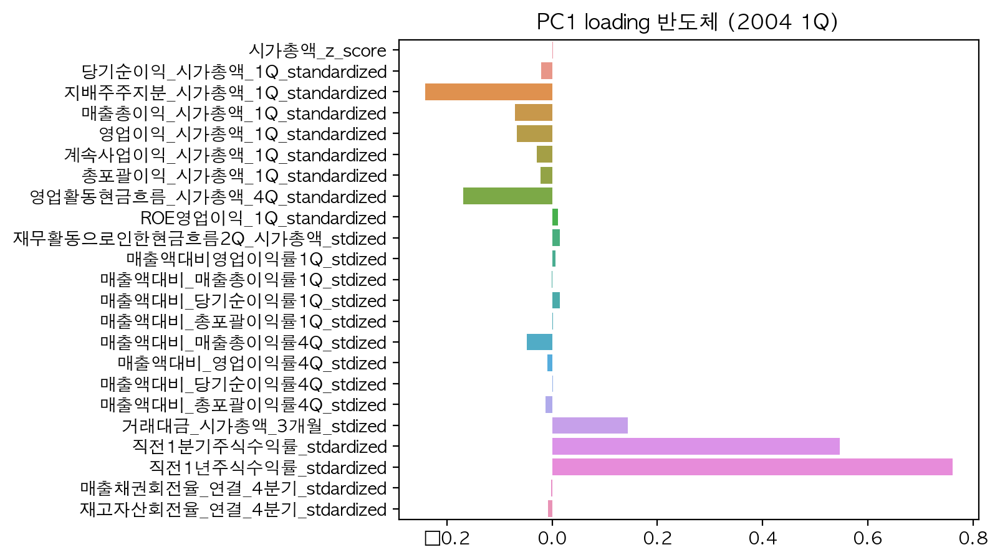

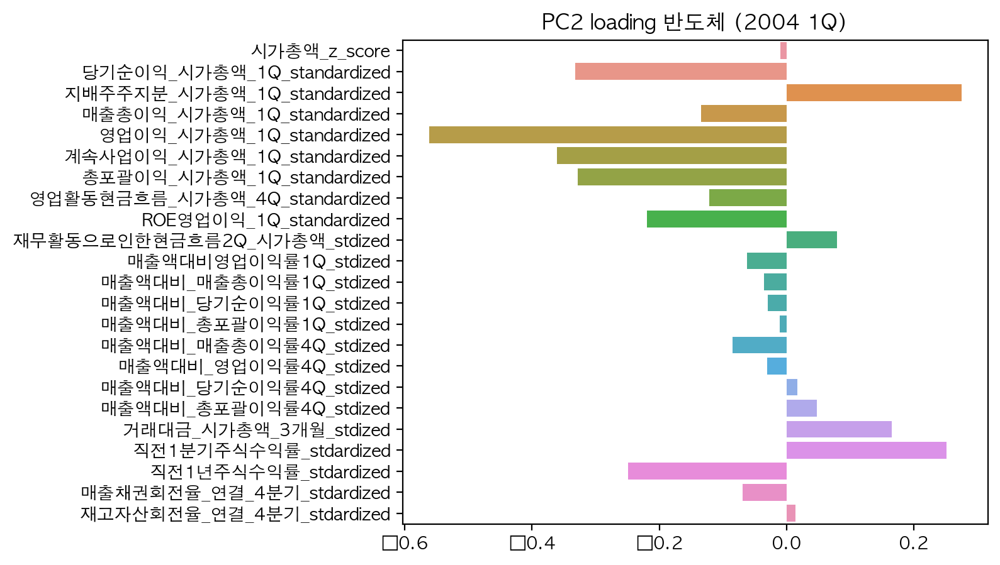

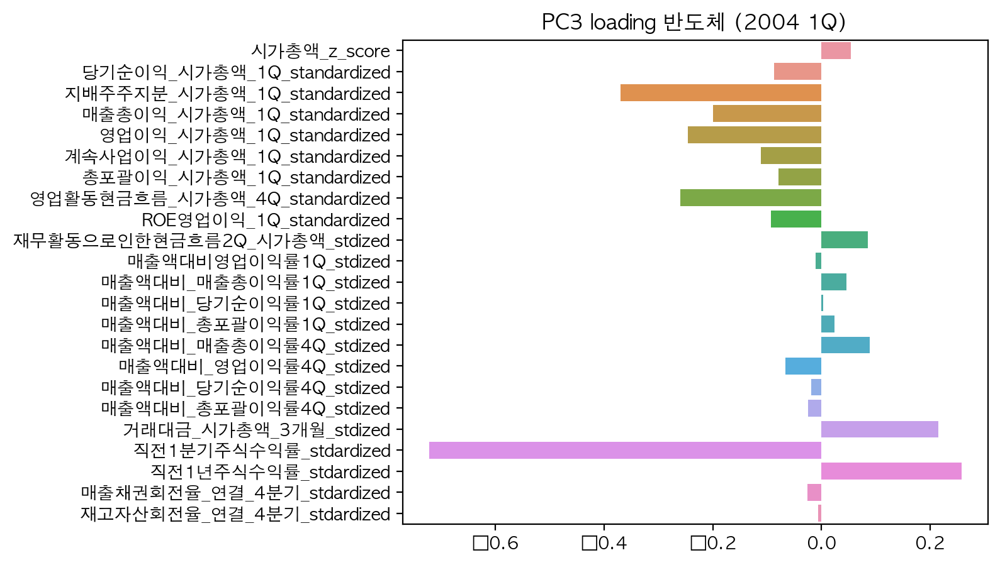

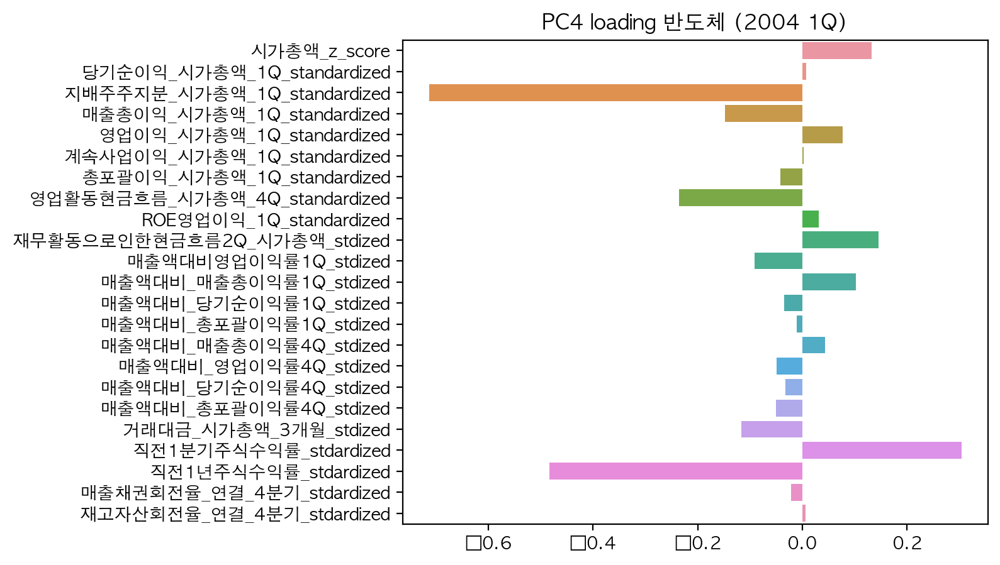

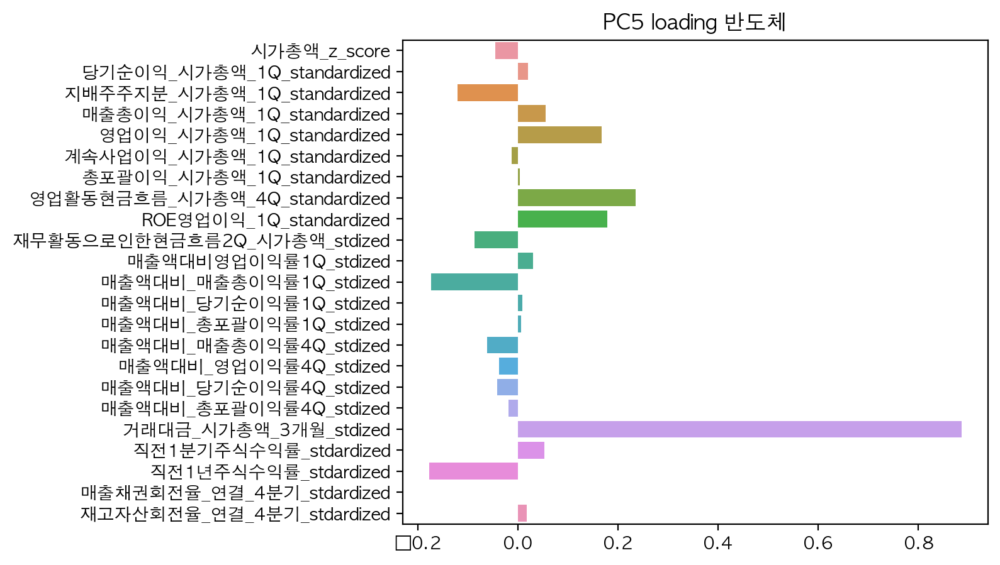

In [20]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(6,5), dpi=200)
plt.title('PC1 loading 반도체 (2004 1Q)')
sns.barplot(x=pca.components_[0], y=industry_pfl_feature_mean.columns)
plt.show()

plt.figure(figsize=(6,5), dpi=200)
plt.title('PC2 loading 반도체 (2004 1Q)')
sns.barplot(x=pca.components_[1], y=industry_pfl_feature_mean.columns)
plt.show()

plt.figure(figsize=(6,5), dpi=200)
plt.title('PC3 loading 반도체 (2004 1Q)')
sns.barplot(x=pca.components_[2], y=industry_pfl_feature_mean.columns)
plt.show()

plt.figure(figsize=(6,5), dpi=200)
plt.title('PC4 loading 반도체 (2004 1Q)')
sns.barplot(x=pca.components_[3], y=industry_pfl_feature_mean.columns)
plt.show()

plt.figure(figsize=(6,5), dpi=200)
plt.title('PC5 loading 반도체')
sns.barplot(x=pca.components_[4], y=industry_pfl_feature_mean.columns)
plt.show()



In [50]:
pd.DataFrame(explained_variance_ratio_df.sum(axis=0), columns=['explained_variance_ratio'])

,explained_variance_ratio
반도체,0.857899
하드웨어,0.840658
제약 및 바이오,0.888028
소재,0.810154
자동차 및 부품,0.836660
소프트웨어,0.841647
자본재,0.834049
은행,0.910165
에너지,0.768330
내구 소비재 및 의류,0.866855


In [27]:
basket=[]
for industry_name in industry_list:
    industry_pfl_return_df=feature_df['투자후1분기뒤수익률'][industry==industry_name].mean()
    basket.append(industry_pfl_return_df)

pfl_return_by_industry=pd.concat(basket,axis=1,keys=industry_list)
pfl_return_by_industry

,반도체,하드웨어,제약 및 바이오,소재,자동차 및 부품,소프트웨어,자본재,은행,에너지,내구 소비재 및 의류,...,운송,생활용품,기타금융,미디어,소비자 서비스,증권,상업서비스,유통,의료장비 및 서비스,부동산
2000-05-31,-0.309356,-0.196104,0.022942,0.143352,0.149442,-0.304474,0.166546,-0.085016,-0.066530,0.338023,...,0.032303,0.116244,-0.180675,-0.239337,-0.213790,0.063265,-0.074806,0.114746,-0.085137,NaN
2000-08-31,-0.327865,-0.266267,0.059965,-0.164557,-0.131002,-0.443635,-0.217316,-0.110674,-0.234439,-0.122623,...,-0.169079,0.072434,-0.361813,-0.364182,-0.263830,-0.315648,-0.312082,-0.225535,-0.273758,NaN
2000-11-30,0.098691,0.033288,0.103593,0.102568,0.027521,0.018334,0.122659,-0.164480,0.116022,0.054973,...,0.064942,0.021203,-0.140212,0.189665,0.142023,0.278402,0.016947,0.176027,0.226582,NaN
2001-03-31,0.105259,0.123700,0.169923,0.166169,0.233929,0.366846,0.194075,0.176368,0.218265,0.169311,...,0.105830,0.134407,0.260621,0.362313,0.185385,0.273135,0.133726,0.355959,0.055050,NaN
2001-05-31,-0.364887,-0.326820,-0.103082,-0.148383,-0.137195,-0.351393,-0.140189,-0.121682,-0.230866,-0.201933,...,-0.156729,-0.125653,-0.160546,-0.268338,-0.101975,-0.152871,-0.153188,-0.153073,-0.179885,-0.322917
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-11-30,0.112958,0.078899,0.014810,0.132203,0.040441,0.000192,0.182569,0.135357,0.097870,0.075404,...,0.141659,0.075195,-0.013418,0.017906,0.207271,0.015130,0.128071,0.074986,0.073740,-0.033962
2022-03-31,-0.038217,-0.004304,-0.048844,-0.014762,-0.004079,-0.127939,0.010202,-0.032864,0.003805,-0.054259,...,-0.002337,-0.022296,-0.025402,-0.148126,-0.137127,-0.077486,-0.000464,-0.080364,-0.045308,-0.097036
2022-05-31,-0.169252,-0.098801,-0.088025,-0.072249,-0.089242,-0.126248,-0.042211,-0.147286,0.017381,-0.078647,...,-0.125365,-0.141627,-0.060126,-0.163099,-0.124181,-0.115010,-0.032037,-0.112780,-0.119350,-0.159048
2022-08-31,-0.082296,-0.092728,-0.136369,-0.039999,-0.021082,-0.105547,-0.021906,0.125499,-0.124507,-0.064474,...,-0.045412,-0.121915,-0.113175,-0.012234,-0.075739,0.018247,-0.048392,-0.138072,-0.093132,-0.137302


In [28]:
pfl_return_by_industry=pfl_return_by_industry[pca_result_by_industry.index[0]:].dropna(how='all')
pfl_return_by_industry

,반도체,하드웨어,제약 및 바이오,소재,자동차 및 부품,소프트웨어,자본재,은행,에너지,내구 소비재 및 의류,...,운송,생활용품,기타금융,미디어,소비자 서비스,증권,상업서비스,유통,의료장비 및 서비스,부동산
2004-03-31,-0.002757,-0.109807,-0.063746,-0.051558,-0.051041,-0.094126,0.017080,-0.041243,-0.048556,-0.045468,...,-0.023500,-0.051272,-0.074132,-0.125542,-0.120803,-0.143837,-0.079088,-0.109556,-0.221029,-0.207407
2004-05-31,-0.180350,-0.140718,0.096083,0.013277,0.015222,-0.160602,-0.032023,-0.095901,-0.020062,-0.062053,...,0.268413,-0.049078,-0.091529,-0.112187,-0.042295,-0.003994,-0.066876,0.031576,-0.097570,-0.056075
2004-08-31,0.025918,-0.046212,0.291077,0.212777,0.055897,-0.059957,0.149382,0.025387,0.115463,0.026661,...,0.218163,-0.036745,0.141966,-0.056753,0.108841,0.067759,0.168419,0.068687,0.051671,0.247525
2004-11-30,0.290204,0.223846,0.464368,0.355659,0.357848,0.370780,0.348591,0.100549,0.232638,0.339823,...,0.197829,0.596818,0.377416,0.428088,0.231564,0.535108,0.249463,0.332760,0.408827,-0.031746
2005-03-31,-0.003863,-0.012910,0.138389,-0.007487,0.017175,0.190583,0.004481,-0.068212,0.059056,0.027886,...,0.007502,0.191459,0.079434,0.087567,0.003166,-0.003091,-0.014474,0.112394,-0.038064,0.024590
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-08-31,-0.085055,-0.091750,-0.211612,-0.145745,-0.165848,0.086244,-0.172496,-0.079616,-0.137945,-0.132524,...,-0.190324,-0.191887,-0.125140,0.105965,-0.128144,-0.093847,-0.217861,-0.173100,-0.148925,-0.139360
2021-11-30,0.112958,0.078899,0.014810,0.132203,0.040441,0.000192,0.182569,0.135357,0.097870,0.075404,...,0.141659,0.075195,-0.013418,0.017906,0.207271,0.015130,0.128071,0.074986,0.073740,-0.033962
2022-03-31,-0.038217,-0.004304,-0.048844,-0.014762,-0.004079,-0.127939,0.010202,-0.032864,0.003805,-0.054259,...,-0.002337,-0.022296,-0.025402,-0.148126,-0.137127,-0.077486,-0.000464,-0.080364,-0.045308,-0.097036
2022-05-31,-0.169252,-0.098801,-0.088025,-0.072249,-0.089242,-0.126248,-0.042211,-0.147286,0.017381,-0.078647,...,-0.125365,-0.141627,-0.060126,-0.163099,-0.124181,-0.115010,-0.032037,-0.112780,-0.119350,-0.159048


# boolean feature

In [29]:
#인더스트리에대한 루프

basket=[]
for industry_name in industry_list:
    
    industry_FeatureName_list=[]
    for feature_name_bool_th in feature_name_bool:
        industry_FeatureName_list.append(feature_df[feature_name_bool_th][industry==industry_name])
        
    industry_feature_df=pd.concat(industry_FeatureName_list,axis=1,keys=feature_name_bool)
    basket.append(industry_feature_df)
    
ALLindustry_N_bool_feature_df=pd.concat(basket,axis=1,keys=industry_list)
ALLindustry_N_bool_feature_df

반도체                                              \
                      매출액증가_TF                                               
                    2000-05-31 2000-08-31 2000-11-30 2001-03-31 2001-05-31   
Symbol Name Symbol                                                           
삼성전자        A005930      False       True       True       True      False   
LG에너지솔루션    A373220        NaN        NaN        NaN        NaN        NaN   
삼성바이오로직스    A207940        NaN        NaN        NaN        NaN        NaN   
SK하이닉스      A000660      False      False       True      False      False   
LG화학        A051910        NaN        NaN        NaN        NaN        NaN   
...                        ...        ...        ...        ...        ...   
평산차업 KDR    A950010        NaN        NaN        NaN        NaN        NaN   
네프로아이티      A950030        NaN        NaN        NaN        NaN        NaN   
중국고섬        A950070        NaN        NaN        NaN        NaN        NaN   
SBI모기지      A950100        NaN        NaN        NaN        NaN        NaN   
SNK         A950180        NaN        NaN        NaN        NaN        NaN   

                                                                            \
                                                                             
                    2001-08-31 2001-11-30 2002-03-31 2002-05-31 2002-08-31   
Symbol Name Symbol                                                           
삼성전자        A005930      False      False       True       True       True   
LG에너지솔루션    A373220        NaN        NaN        NaN        NaN        NaN   
삼성바이오로직스    A207940        NaN        NaN        NaN        NaN        NaN   
SK하이닉스      A000660      False      False      False       True      False   
LG화학        A051910        NaN        NaN        NaN        NaN        NaN   
...                        ...        ...        ...        ...        ...   
평산차업 KDR    A950010        NaN        NaN        NaN        NaN        NaN   
네프로아이티      A950030        NaN        NaN        NaN        NaN        NaN   
중국고섬        A950070        NaN        NaN        NaN        NaN        NaN   
SBI모기지      A950100        NaN        NaN        NaN        NaN        NaN   
SNK         A950180        NaN        NaN        NaN        NaN        NaN   

                     ...        부동산                                   \
                     ... 총포괄이익_흑자TF                                    
                     ... 2020-08-31 2020-11-30 2021-03-31 2021-05-31   
Symbol Name Symbol   ...                                               
삼성전자        A005930  ...        NaN        NaN        NaN        NaN   
LG에너지솔루션    A373220  ...        NaN        NaN        NaN        NaN   
삼성바이오로직스    A207940  ...        NaN        NaN        NaN        NaN   
SK하이닉스      A000660  ...        NaN        NaN        NaN        NaN   
LG화학        A051910  ...        NaN        NaN        NaN        NaN   
...                  ...        ...        ...        ...        ...   
평산차업 KDR    A950010  ...        NaN        NaN        NaN        NaN   
네프로아이티      A950030  ...        NaN        NaN        NaN        NaN   
중국고섬        A950070  ...        NaN        NaN        NaN        NaN   
SBI모기지      A950100  ...        NaN        NaN        NaN        NaN   
SNK         A950180  ...        NaN        NaN        NaN        NaN   

                                                                            \
                                                                             
                    2021-08-31 2021-11-30 2022-03-31 2022-05-31 2022-08-31   
Symbol Name Symbol                                                           
삼성전자        A005930        NaN        NaN        NaN        NaN        NaN   
LG에너지솔루션    A373220        NaN        NaN        NaN        NaN        NaN   
삼성바이오로직스    A207940        NaN        NaN        NaN        NaN        NaN   
SK하이닉스      A000660        NaN        NaN        NaN      

In [30]:
industry_pfl_bool_feature_mean_list=[]

for ind_name in tqdm(industry_list):
    industry_pfl_bool_feature_mean=ALLindustry_N_bool_feature_df[ind_name].T.mean(axis=1).unstack().T.dropna()
    industry_pfl_bool_feature_mean_list.append(industry_pfl_bool_feature_mean)
    
industry_pfl_bool_feature_mean_df=pd.concat(industry_pfl_bool_feature_mean_list,axis=1,keys=industry_list)
industry_pfl_bool_feature_mean_df

100%|██████████| 25/25 [00:18<00:00,  1.33it/s]


반도체                                                         \
            매출액증가_TF 매출총이익증가_TF 영업이익증가_TF 당기순이익증가_TF 총포괄이익증가_TF 매출액_4Q증가_TF   
2001-03-31  0.476190   0.452381  0.428571   0.357143   0.357143    0.000000   
2001-05-31  0.363636   0.363636  0.431818   0.613636   0.613636    0.454545   
2001-08-31  0.468085   0.446809  0.382979   0.297872   0.297872    0.297872   
2001-11-30  0.291667   0.354167  0.375000   0.354167   0.291667    0.291667   
2002-03-31  0.545455   0.454545  0.400000   0.400000   0.381818    0.400000   
...              ...        ...       ...        ...        ...         ...   
2021-11-30  0.516129   0.580645  0.580645   0.548387   0.572581    0.758065   
2022-03-31  0.736434   0.596899  0.465116   0.418605   0.457364    0.860465   
2022-05-31  0.558140   0.558140  0.565891   0.604651   0.581395    0.767442   
2022-08-31  0.691729   0.646617  0.548872   0.563910   0.563910    0.684211   
2022-11-30  0.455224   0.470149  0.440299   0.537313   0.597015    0.671642   

                                                                   ...  \
           매출총이익_4Q증가_TF 영업이익_4Q증가_TF 당기순이익_4Q증가_TF 총포괄이익_4Q증가_TF  ...   
2001-03-31      0.000000     0.000000      0.000000      0.000000  ...   
2001-05-31      0.363636     0.295455      0.340909      0.340909  ...   
2001-08-31      0.255319     0.170213      0.148936      0.191489  ...   
2001-11-30      0.208333     0.062500      0.125000      0.125000  ...   
2002-03-31      0.309091     0.290909      0.400000      0.454545  ...   
...                  ...          ...           ...           ...  ...   
2021-11-30      0.725806     0.669355      0.693548      0.677419  ...   
2022-03-31      0.806202     0.736434      0.682171      0.689922  ...   
2022-05-31      0.751938     0.697674      0.620155      0.596899  ...   
2022-08-31      0.699248     0.586466      0.631579      0.631579  ...   
2022-11-30      0.611940     0.537313      0.641791      0.656716  ...   

                                     부동산                                 \
           매출액대비_영업이익률4Q_stdized_4Q증가_TF 매출액대비_당기순이익률4Q_stdized_4Q증가_TF   
2001-03-31                           NaN                            NaN   
2001-05-31                           0.0                            0.0   
2001-08-31                           0.0                            0.0   
2001-11-30                           0.0                            0.0   
2002-03-31                           0.0                            0.0   
...                                  ...                            ...   
2021-11-30                           1.0                            0.0   
2022-03-31                           0.0                            0.0   
2022-05-31                           0.0                            0.0   
2022-08-31                           0.0                            0.0   
2022-11-30                           0.5                            1.0   

                                                                          \
           매출액대비_총포괄이익률4Q_stdized_4Q증가_TF CB보유TF BW보유TF 자본금_12분기전대비증가_TF   
2001-03-31                            NaN    NaN    NaN              NaN   
2001-05-31                            0.0    0.0    0.0         0.000000   
2001-08-31                            0.0    0.0    0.0         0.000000   
2001-11-30                            0.0    0.0    0.0         0.000000   
2002-03-31                            0.0    0.0    0.0         0.000000   
...                                   ...    ...    ...              ...   
2021-11-30                            0.0    0.0    0.0         0.571429   
2022-03-31                            0.0    0.0    0.0         0.400000   
2022-05-31                            0.0    0.0    0.0         0.400000   
2022-08-31                            0.0    0.0    0.0         0.400000   
2022-11-30                            1.0    0.0    0.0         0.400000   

                                                        
    

In [ ]:
# pca_result_by_industry.to_pickle('pca_result_by_industry.pkl')
# explained_variance_ratio_df.to_pickle('explained_variance_ratio_df.pkl')
# pca_components_df.to_pickle('pca_components_df.pkl')
# pfl_return_by_industry.to_pickle('pfl_return_by_industry.pkl')
# industry_pfl_bool_feature_mean_df.to_pickle('industry_pfl_bool_feature_mean_df.pkl')

In [31]:
pca_result_by_industry

반도체                                              하드웨어  \
                 PC1       PC2       PC3       PC4       PC5       PC1   
2004-03-31  0.606931 -0.153560  0.215650  0.219794 -0.058570 -0.354762   
2004-05-31  0.699964  0.074882  0.440733  0.147695  0.076898 -0.332715   
2004-08-31 -0.106693 -0.113768  0.518941  0.161251 -0.015912 -0.491851   
2004-11-30 -0.067721 -0.247340  0.198719  0.223901  0.085951 -0.556461   
2005-03-31 -0.173706 -0.039787  0.123254  0.306531 -0.007363 -0.325858   
...              ...       ...       ...       ...       ...       ...   
2021-11-30  0.152337 -0.060479 -0.033649  0.036531 -0.146191  0.077798   
2022-03-31  0.049541 -0.263551 -0.102984  0.008789  0.011108  0.053148   
2022-05-31  0.056446 -0.231371  0.005892 -0.061113 -0.143920  0.297502   
2022-08-31 -0.302524 -0.247698  0.150117 -0.101951 -0.125840  0.139629   
2022-11-30 -0.268008 -0.198439 -0.144255  0.062722 -0.039368  0.099579   

                                                    ... 의료장비 및 서비스            \
                 PC2       PC3       PC4       PC5  ...        PC1       PC2   
2004-03-31  0.376233 -0.072579  0.052110  0.130024  ...   0.179064  0.439153   
2004-05-31  0.465633  0.083650 -0.085561  0.052461  ...   0.102755  0.233852   
2004-08-31 -0.008532 -0.068776  0.145720  0.238471  ...  -0.378530  0.573200   
2004-11-30 -0.032139 -0.057164  0.058904  0.233295  ...  -0.220056  0.428555   
2005-03-31 -0.055199  0.000557  0.033695  0.346175  ...   0.014933  0.460484   
...              ...       ...       ...       ...  ...        ...       ...   
2021-11-30 -0.004130 -0.161647 -0.095227  0.166021  ...  -0.442859  0.022569   
2022-03-31  0.097311 -0.231106  0.003107  0.086474  ...  -0.117969  0.104290   
2022-05-31  0.135271 -0.284928  0.018223  0.023872  ...  -0.236319  0.182707   
2022-08-31  0.086979 -0.258016  0.074096  0.041820  ...  -0.382312  0.134303   
2022-11-30 -0.104044 -0.212301  0.043035  0.137928  ...  -0.395251  0.060882   

                                               부동산                      \
                 PC3       PC4       PC5       PC1       PC2       PC3   
2004-03-31 -0.081843  0.070686  0.523772       NaN       NaN       NaN   
2004-05-31 -0.125022  0.539082 -0.148899       NaN       NaN       NaN   
2004-08-31  0.048775 -0.122956  0.087318       NaN       NaN       NaN   
2004-11-30  0.008293 -0.259560 -0.198885       NaN       NaN       NaN   
2005-03-31  0.067222 -0.164872  0.140818       NaN       NaN       NaN   
...              ...       ...       ...       ...       ...       ...   
2021-11-30  0.286506 -0.057658 -0.259927 -0.986050  0.795707 -0.296879   
2022-03-31  0.164161 -0.019484 -0.197321 -1.285525  0.302333 -0.467787   
2022-05-31  0.140421 -0.218417 -0.220707 -1.241121 -0.418311 -0.535015   
2022-08-31  0.248388  0.077776 -0.185304 -1.463120 -0.591622 -0.479072   
2022-11-30  0.311278  0.018301 -0.209323 -1.570857 -0.280180 -0.187069   

                                
                 PC4       PC5  
2004-03-31       NaN       NaN  
2004-05-31       NaN       NaN  
2004-08-31       NaN       NaN  
2004-11-30       NaN       NaN  
2005-03-31       NaN       NaN  
...              ...       ...  
2021-11-30  0.268750  0.173042  
2022-03-31  0.413944  0.766072  
2022-05-31  0.897158  0.043391  
2022-08-31  0.398329 -0.211639  
2022-11-30 -0.078026 -0.362835  

[75 rows x 125 columns]

In [32]:
df = industry_pfl_bool_feature_mean_df

In [33]:
industry_pfl_bool_feature_mean_df

반도체                                                         \
            매출액증가_TF 매출총이익증가_TF 영업이익증가_TF 당기순이익증가_TF 총포괄이익증가_TF 매출액_4Q증가_TF   
2001-03-31  0.476190   0.452381  0.428571   0.357143   0.357143    0.000000   
2001-05-31  0.363636   0.363636  0.431818   0.613636   0.613636    0.454545   
2001-08-31  0.468085   0.446809  0.382979   0.297872   0.297872    0.297872   
2001-11-30  0.291667   0.354167  0.375000   0.354167   0.291667    0.291667   
2002-03-31  0.545455   0.454545  0.400000   0.400000   0.381818    0.400000   
...              ...        ...       ...        ...        ...         ...   
2021-11-30  0.516129   0.580645  0.580645   0.548387   0.572581    0.758065   
2022-03-31  0.736434   0.596899  0.465116   0.418605   0.457364    0.860465   
2022-05-31  0.558140   0.558140  0.565891   0.604651   0.581395    0.767442   
2022-08-31  0.691729   0.646617  0.548872   0.563910   0.563910    0.684211   
2022-11-30  0.455224   0.470149  0.440299   0.537313   0.597015    0.671642   

                                                                   ...  \
           매출총이익_4Q증가_TF 영업이익_4Q증가_TF 당기순이익_4Q증가_TF 총포괄이익_4Q증가_TF  ...   
2001-03-31      0.000000     0.000000      0.000000      0.000000  ...   
2001-05-31      0.363636     0.295455      0.340909      0.340909  ...   
2001-08-31      0.255319     0.170213      0.148936      0.191489  ...   
2001-11-30      0.208333     0.062500      0.125000      0.125000  ...   
2002-03-31      0.309091     0.290909      0.400000      0.454545  ...   
...                  ...          ...           ...           ...  ...   
2021-11-30      0.725806     0.669355      0.693548      0.677419  ...   
2022-03-31      0.806202     0.736434      0.682171      0.689922  ...   
2022-05-31      0.751938     0.697674      0.620155      0.596899  ...   
2022-08-31      0.699248     0.586466      0.631579      0.631579  ...   
2022-11-30      0.611940     0.537313      0.641791      0.656716  ...   

                                     부동산                                 \
           매출액대비_영업이익률4Q_stdized_4Q증가_TF 매출액대비_당기순이익률4Q_stdized_4Q증가_TF   
2001-03-31                           NaN                            NaN   
2001-05-31                           0.0                            0.0   
2001-08-31                           0.0                            0.0   
2001-11-30                           0.0                            0.0   
2002-03-31                           0.0                            0.0   
...                                  ...                            ...   
2021-11-30                           1.0                            0.0   
2022-03-31                           0.0                            0.0   
2022-05-31                           0.0                            0.0   
2022-08-31                           0.0                            0.0   
2022-11-30                           0.5                            1.0   

                                                                          \
           매출액대비_총포괄이익률4Q_stdized_4Q증가_TF CB보유TF BW보유TF 자본금_12분기전대비증가_TF   
2001-03-31                            NaN    NaN    NaN              NaN   
2001-05-31                            0.0    0.0    0.0         0.000000   
2001-08-31                            0.0    0.0    0.0         0.000000   
2001-11-30                            0.0    0.0    0.0         0.000000   
2002-03-31                            0.0    0.0    0.0         0.000000   
...                                   ...    ...    ...              ...   
2021-11-30                            0.0    0.0    0.0         0.571429   
2022-03-31                            0.0    0.0    0.0         0.400000   
2022-05-31                            0.0    0.0    0.0         0.400000   
2022-08-31                            0.0    0.0    0.0         0.400000   
2022-11-30                            1.0    0.0    0.0         0.400000   

                                                        
    

In [34]:
pfl_return_by_industry

,반도체,하드웨어,제약 및 바이오,소재,자동차 및 부품,소프트웨어,자본재,은행,에너지,내구 소비재 및 의류,...,운송,생활용품,기타금융,미디어,소비자 서비스,증권,상업서비스,유통,의료장비 및 서비스,부동산
2004-03-31,-0.002757,-0.109807,-0.063746,-0.051558,-0.051041,-0.094126,0.017080,-0.041243,-0.048556,-0.045468,...,-0.023500,-0.051272,-0.074132,-0.125542,-0.120803,-0.143837,-0.079088,-0.109556,-0.221029,-0.207407
2004-05-31,-0.180350,-0.140718,0.096083,0.013277,0.015222,-0.160602,-0.032023,-0.095901,-0.020062,-0.062053,...,0.268413,-0.049078,-0.091529,-0.112187,-0.042295,-0.003994,-0.066876,0.031576,-0.097570,-0.056075
2004-08-31,0.025918,-0.046212,0.291077,0.212777,0.055897,-0.059957,0.149382,0.025387,0.115463,0.026661,...,0.218163,-0.036745,0.141966,-0.056753,0.108841,0.067759,0.168419,0.068687,0.051671,0.247525
2004-11-30,0.290204,0.223846,0.464368,0.355659,0.357848,0.370780,0.348591,0.100549,0.232638,0.339823,...,0.197829,0.596818,0.377416,0.428088,0.231564,0.535108,0.249463,0.332760,0.408827,-0.031746
2005-03-31,-0.003863,-0.012910,0.138389,-0.007487,0.017175,0.190583,0.004481,-0.068212,0.059056,0.027886,...,0.007502,0.191459,0.079434,0.087567,0.003166,-0.003091,-0.014474,0.112394,-0.038064,0.024590
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-08-31,-0.085055,-0.091750,-0.211612,-0.145745,-0.165848,0.086244,-0.172496,-0.079616,-0.137945,-0.132524,...,-0.190324,-0.191887,-0.125140,0.105965,-0.128144,-0.093847,-0.217861,-0.173100,-0.148925,-0.139360
2021-11-30,0.112958,0.078899,0.014810,0.132203,0.040441,0.000192,0.182569,0.135357,0.097870,0.075404,...,0.141659,0.075195,-0.013418,0.017906,0.207271,0.015130,0.128071,0.074986,0.073740,-0.033962
2022-03-31,-0.038217,-0.004304,-0.048844,-0.014762,-0.004079,-0.127939,0.010202,-0.032864,0.003805,-0.054259,...,-0.002337,-0.022296,-0.025402,-0.148126,-0.137127,-0.077486,-0.000464,-0.080364,-0.045308,-0.097036
2022-05-31,-0.169252,-0.098801,-0.088025,-0.072249,-0.089242,-0.126248,-0.042211,-0.147286,0.017381,-0.078647,...,-0.125365,-0.141627,-0.060126,-0.163099,-0.124181,-0.115010,-0.032037,-0.112780,-0.119350,-0.159048


In [35]:
sector_list = pca_result_by_industry.columns.get_level_values(0).unique()

# Reg 만들기

In [36]:
sector_name = []

for idx in sector_list:
    x = pca_result_by_industry[idx]

    if len(x.dropna()) < 75:
        pass
    else:
        sector_name.append(idx)

In [37]:
reg_df = pd.DataFrame(index=sector_name)

# Logistic Regression

In [57]:
x = pca_result_by_industry['반도체']
y = pfl_return_by_industry['반도체']

In [77]:
y

2004-03-31   -0.002757
2004-05-31   -0.180350
2004-08-31    0.025918
2004-11-30    0.290204
2005-03-31   -0.003863
                ...   
2021-08-31   -0.085055
2021-11-30    0.112958
2022-03-31   -0.038217
2022-05-31   -0.169252
2022-08-31   -0.082296
Name: 반도체, Length: 75, dtype: float64

In [86]:
tmp = pd.DataFrame(index=pd.date_range(x.index[0], x.index[-1], freq='M'))
tmp = pd.concat([tmp, x], axis=1)
x = tmp.interpolate()

tmp = pd.DataFrame(index=pd.date_range(x.index[0], x.index[-1], freq='M'))
tmp = pd.concat([tmp, y], axis=1)
y = tmp.interpolate()

In [87]:
x

,PC1,PC2,PC3,PC4,PC5
2004-03-31,0.606931,-0.153560,0.215650,0.219794,-0.058570
2004-04-30,0.653447,-0.039339,0.328192,0.183745,0.009164
2004-05-31,0.699964,0.074882,0.440733,0.147695,0.076898
2004-06-30,0.431078,0.011999,0.466803,0.152214,0.045962
2004-07-31,0.162193,-0.050884,0.492872,0.156733,0.015025
...,...,...,...,...,...
2022-07-31,-0.182867,-0.242256,0.102042,-0.088338,-0.131866
2022-08-31,-0.302524,-0.247698,0.150117,-0.101951,-0.125840
2022-09-30,-0.291018,-0.231278,0.051993,-0.047060,-0.097016
2022-10-31,-0.279513,-0.214859,-0.046131,0.007831,-0.068192


In [88]:
y

,0
2004-03-31,0.0
2004-04-30,0.0
2004-05-31,0.0
2004-06-30,0.0
2004-07-31,0.0
...,...
2022-07-31,0.0
2022-08-31,0.0
2022-09-30,0.0
2022-10-31,0.0


In [67]:
tmp = pd.date_range(x.index[0], x.index[-1], freq='M')

DatetimeIndex(['2004-03-31', '2004-04-30', '2004-05-31', '2004-06-30',
               '2004-07-31', '2004-08-31', '2004-09-30', '2004-10-31',
               '2004-11-30', '2004-12-31',
               ...
               '2022-02-28', '2022-03-31', '2022-04-30', '2022-05-31',
               '2022-06-30', '2022-07-31', '2022-08-31', '2022-09-30',
               '2022-10-31', '2022-11-30'],
              dtype='datetime64[ns]', length=225, freq='M')

In [59]:
x.interpolate(metho='time')

,PC1,PC2,PC3,PC4,PC5
2004-03-31,0.606931,-0.153560,0.215650,0.219794,-0.058570
2004-05-31,0.699964,0.074882,0.440733,0.147695,0.076898
2004-08-31,-0.106693,-0.113768,0.518941,0.161251,-0.015912
2004-11-30,-0.067721,-0.247340,0.198719,0.223901,0.085951
2005-03-31,-0.173706,-0.039787,0.123254,0.306531,-0.007363
...,...,...,...,...,...
2021-11-30,0.152337,-0.060479,-0.033649,0.036531,-0.146191
2022-03-31,0.049541,-0.263551,-0.102984,0.008789,0.011108
2022-05-31,0.056446,-0.231371,0.005892,-0.061113,-0.143920
2022-08-31,-0.302524,-0.247698,0.150117,-0.101951,-0.125840


In [38]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, f1_score
from sklearn.ensemble import AdaBoostClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

acc_list_logit = []
f1_list_logit = []

for idx in sector_list:
    x = pca_result_by_industry[idx]

    if len(x.dropna()) < 75:
        pass
    else:
        
        y = pfl_return_by_industry[idx]

        # tmp = pd.DataFrame(index=pd.date_range(x.index[0], x.index[-1], freq='M'))
        # tmp = pd.concat([tmp, x], axis=1)
        # x = tmp.interpolate()

        # tmp = pd.DataFrame(index=pd.date_range(x.index[0], x.index[-1], freq='M'))
        # tmp = pd.concat([tmp, y], axis=1)
        # y = tmp.interpolate()

        y = pd.DataFrame(np.where(y>0, 1, 0), index=y.index)



        print(f'--------------------- {idx} Sector Start ---------------------')
        
        X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.25, shuffle=False)

        print(f'X, Y train Length {len(X_train)}')
        print(f'X, Y  test Length {len(y_test)}')


        logit = LogisticRegression()

        logit.fit(X_train, y_train.values.ravel())

        acc = accuracy_score(y_test, logit.predict(X_test))
        f1  = f1_score(y_test, logit.predict(X_test))
#        acc = accuracy_score(reg.predict(X_test), y_test)
        print(idx)
        print(f1)
        print(np.round(acc * 100, 2))
        
        acc_list_logit.append(acc)
        f1_list_logit.append(f1)

reg_df['Logit Reg(acc)_ori'] = acc_list_logit
reg_df['Logit Reg(f1)_ori'] = f1_list_logit

--------------------- 반도체 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
반도체
0.7857142857142858
68.42
--------------------- 하드웨어 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
하드웨어
0.7333333333333334
57.89
--------------------- 제약 및 바이오 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
제약 및 바이오
0.761904761904762
73.68
--------------------- 소재 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
소재
0.7333333333333334
57.89
--------------------- 자동차 및 부품 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
자동차 및 부품
0.6153846153846153
47.37
--------------------- 소프트웨어 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
소프트웨어
0.8571428571428571
78.95
--------------------- 자본재 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
자본재
0.7333333333333334
57.89
--------------------- 에너지 Sector Start --------------

In [39]:
reg_df

,Logit Reg(acc)_ori,Logit Reg(f1)_ori
반도체,0.684211,0.785714
하드웨어,0.578947,0.733333
제약 및 바이오,0.736842,0.761905
소재,0.578947,0.733333
자동차 및 부품,0.473684,0.615385
소프트웨어,0.789474,0.857143
자본재,0.578947,0.733333
에너지,0.789474,0.846154
내구 소비재 및 의류,0.473684,0.642857
디스플레이,0.631579,0.695652


In [126]:
comp

,Logit Reg(acc),Logit Reg(f1),Logit Reg(acc)_ori,Logit Reg(f1)_ori,acc,f1
반도체,0.561404,0.719101,0.684211,0.785714,0.616099,0.500000
하드웨어,0.508772,0.674419,0.578947,0.733333,0.582798,0.338086
제약 및 바이오,0.421053,0.507463,0.736842,0.761905,0.603509,0.538776
소재,0.543860,0.704545,0.578947,0.733333,0.521629,0.558990
자동차 및 부품,0.473684,0.642857,0.473684,0.615385,0.573770,0.413302
소프트웨어,0.666667,0.765432,0.789474,0.857143,0.543860,0.557823
자본재,0.526316,0.689655,0.578947,0.733333,0.571704,0.611476
에너지,0.578947,0.727273,0.789474,0.846154,0.504386,0.323353
내구 소비재 및 의류,0.491228,0.658824,0.473684,0.642857,0.581140,0.439883
디스플레이,0.508772,0.641026,0.631579,0.695652,0.601504,0.453608


In [123]:
comp = pd.concat([reg_df, tmp], axis=1).dropna()

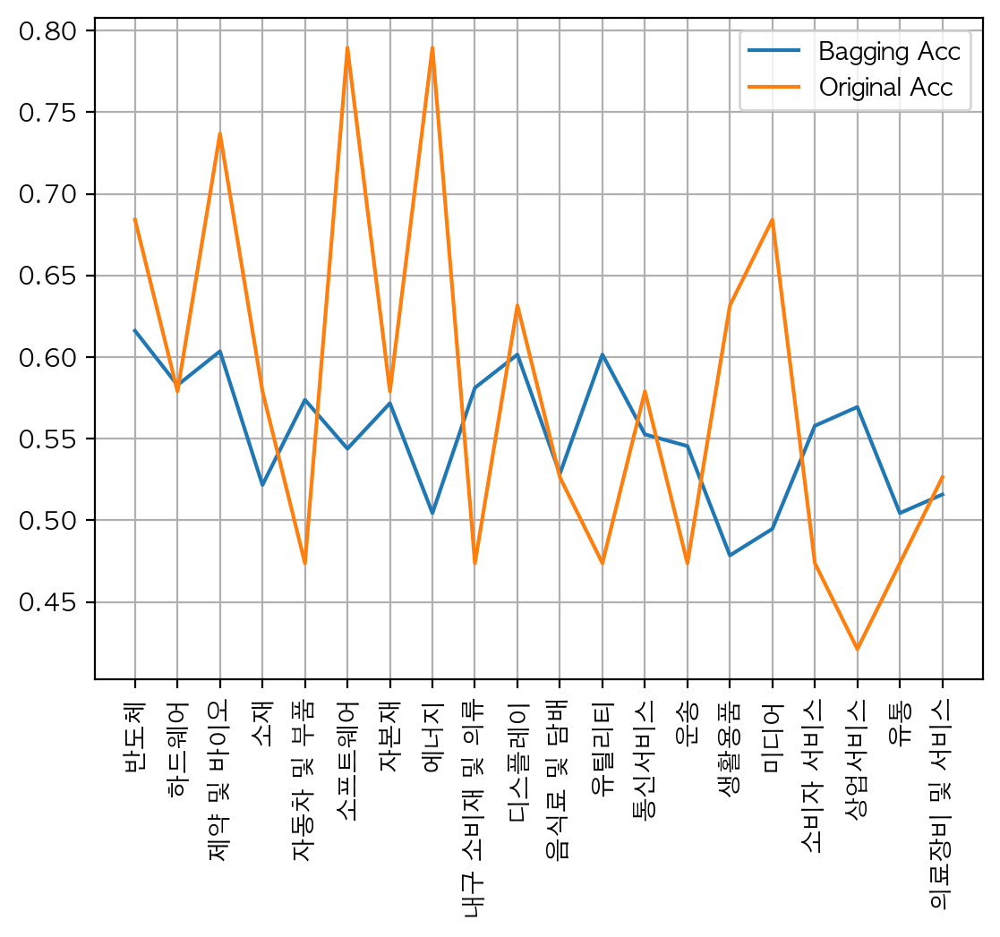

In [131]:
plt.figure(dpi=200)
plt.plot(comp.index, comp[comp.columns[4]], label='Bagging Acc')
plt.plot(comp.index, comp[comp.columns[2]], label='Original Acc')
plt.xticks(rotation=90)
plt.legend()
plt.grid()
plt.show()

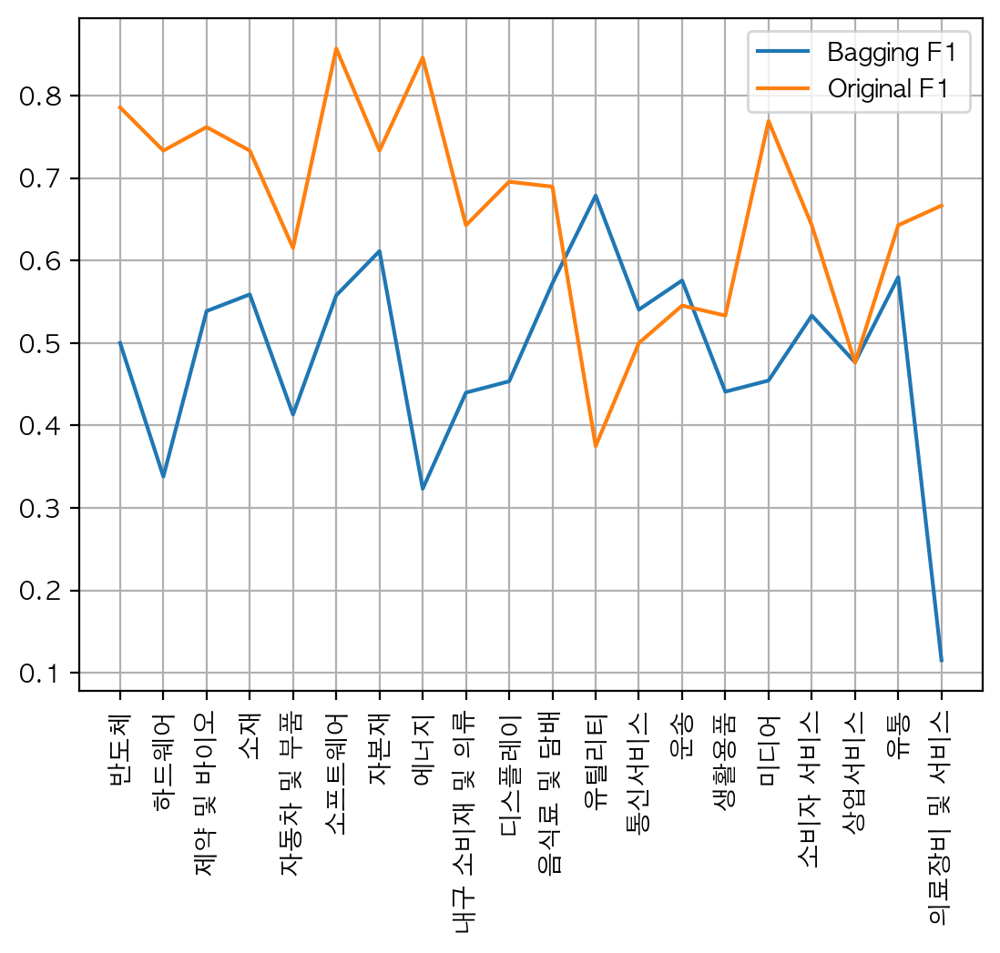

In [132]:
plt.figure(dpi=200)
plt.plot(comp.index, comp[comp.columns[5]], label='Bagging F1')
plt.plot(comp.index, comp[comp.columns[3]], label='Original F1')
plt.xticks(rotation=90)
plt.legend()
plt.grid()
plt.show()

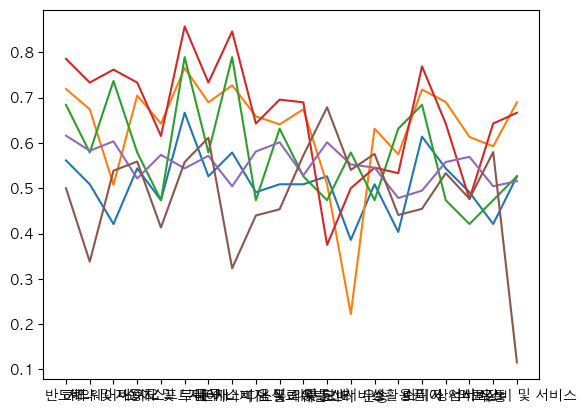

In [124]:
plt.plot(comp)

In [117]:
tmp = pd.read_pickle('baggin_reg.pkl')
tmp

,acc,f1
하드웨어,0.582798,0.338086
제약 및 바이오,0.603509,0.538776
반도체,0.616099,0.500000
소재,0.521629,0.558990
자동차 및 부품,0.573770,0.413302
소프트웨어,0.543860,0.557823
자본재,0.571704,0.611476
은행,0.438596,0.111111
에너지,0.504386,0.323353
내구 소비재 및 의류,0.581140,0.439883


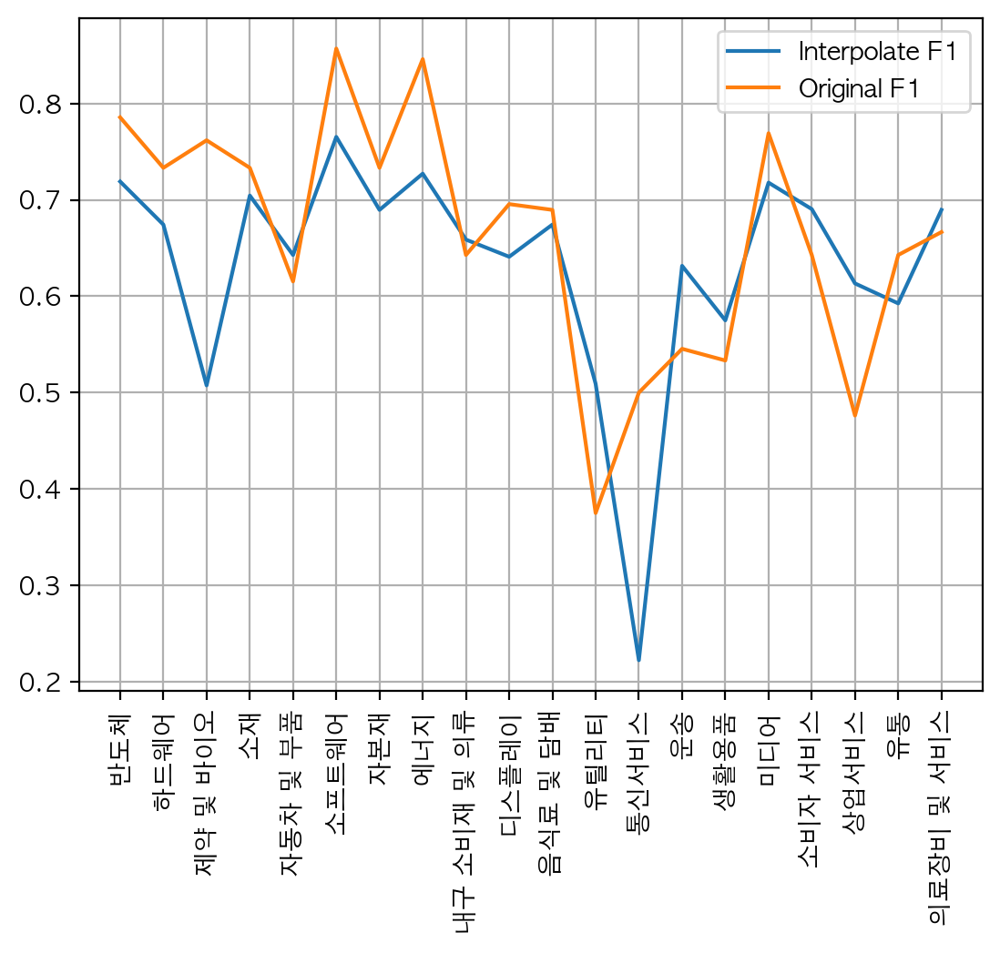

In [108]:
plt.figure(dpi=200)
plt.plot(reg_df.index, reg_df[reg_df.columns[1]], label='Interpolate F1')
plt.plot(reg_df.index, reg_df[reg_df.columns[3]], label='Original F1')
plt.xticks(rotation=90)
plt.legend()
plt.grid()
plt.show()


In [42]:
reg_df

,Logit Reg(acc)_ori,Logit Reg(f1)_ori
반도체,0.684211,0.785714
하드웨어,0.578947,0.733333
제약 및 바이오,0.736842,0.761905
소재,0.578947,0.733333
자동차 및 부품,0.473684,0.615385
소프트웨어,0.789474,0.857143
자본재,0.578947,0.733333
에너지,0.789474,0.846154
내구 소비재 및 의류,0.473684,0.642857
디스플레이,0.631579,0.695652


# Adaboost

In [43]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, f1_score
from sklearn.ensemble import AdaBoostClassifier

acc_list_ada = []
f1_list_ada = []
for idx in sector_list:


    x = pca_result_by_industry[idx]
    y = pfl_return_by_industry[idx]
    y = pd.DataFrame(np.where(y>0, 1, 0), index=y.index)


    if len(x.dropna()) < 75:
        pass
    else:
        
        y = pfl_return_by_industry[idx]
        y = pd.DataFrame(np.where(y>0, 1, 0), index=y.index)

        print(f'--------------------- {idx} Sector Start ---------------------')
        
        X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.25, shuffle=False)

        print(f'X, Y train Length {len(X_train)}')
        print(f'X, Y  test Length {len(y_test)}')


        ad = AdaBoostClassifier(DecisionTreeClassifier(random_state=1), random_state=1, algorithm='SAMME.R')

        params = {
            'base_estimator__max_depth': [1, 2, 3],
            'base_estimator__min_samples_split' : [1, 2, 3],
            'base_estimator__min_samples_leaf' : np.arange(1, 20, 1),
            'base_estimator__max_leaf_nodes' : [1, 2, 3],
            
            'n_estimators': list(np.arange(10, 50, 1)),
        }

        grid_ad = GridSearchCV(ad, param_grid=params, cv=3, scoring='accuracy', refit=True, verbose=1, n_jobs=-1)
        grid_ad.fit(X_train, y_train.values.ravel())

        grid_score_df = pd.DataFrame(grid_ad.cv_results_)

        ad_tuned = grid_ad.best_estimator_

#        reg = bag.fit(X_train, y_train)
        acc = accuracy_score(y_test, ad_tuned.predict(X_test))
        f1  = f1_score(y_test, ad_tuned.predict(X_test))
#        acc = accuracy_score(reg.predict(X_test), y_test)
        print(idx)
        print(f1)
        print(np.round(acc * 100, 2))
        
        acc_list_ada.append(acc)
        f1_list_ada.append(f1)

reg_df['Adaboost Reg(Acc)'] = acc_list_ada
reg_df['Adaboost Reg(f1)'] = f1_list_ada


--------------------- 반도체 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 20520 candidates, totalling 61560 fits
반도체
0.7142857142857143
57.89
--------------------- 하드웨어 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 20520 candidates, totalling 61560 fits
하드웨어
0.45454545454545453
36.84
--------------------- 제약 및 바이오 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 20520 candidates, totalling 61560 fits
제약 및 바이오
0.5263157894736842
52.63
--------------------- 소재 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 20520 candidates, totalling 61560 fits
소재
0.7407407407407406
63.16
--------------------- 자동차 및 부품 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 20520 candidates, totalling 61560 fits
자동차 및 부품
0.6666666

# Bagging

In [44]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, f1_score
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.model_selection import train_test_split

acc_list_bag = []
f1_list_bag = []
for idx in sector_list:
    x = pca_result_by_industry[idx]

    if len(x.dropna()) < 75:
        pass
    else:
        
        y = pfl_return_by_industry[idx]
        y = pd.DataFrame(np.where(y>0, 1, 0), index=y.index)

        print(f'--------------------- {idx} Sector Start ---------------------')
        
        X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.25, shuffle=False)

        print(f'X, Y train Length {len(X_train)}')
        print(f'X, Y  test Length {len(y_test)}')


        bag = BaggingClassifier(DecisionTreeClassifier(random_state=1), bootstrap=True, oob_score=True, random_state=3)
        #bag.fit(X_train_sc, y_train)
        #bag.oob_score_
        #accuracy_score(y_test, bag.predict(X_test_sc))

        params = {
            'base_estimator__max_depth': [1, 3, 5],
            'base_estimator__min_samples_split' : [1, 2, 3],
            'base_estimator__min_samples_leaf' : [5, 10, 15],
            'base_estimator__max_leaf_nodes' : [1, 2, 3, 4, 5],

            'n_estimators' : list(np.arange(5, 15 ,1)),
            'max_samples' : list(np.arange(0.2, 0.8, 0.2)),
        }

        grid_bag = GridSearchCV(bag, param_grid=params, cv=3, scoring='accuracy', refit=True, verbose=1, n_jobs=-1)
        grid_bag.fit(X_train, y_train.values.ravel())

        grid_score_df = pd.DataFrame(grid_bag.cv_results_)

        bag_tuned = grid_bag.best_estimator_

#        reg = bag.fit(X_train, y_train)
        acc = accuracy_score(y_test, bag_tuned.predict(X_test))
        f1  = f1_score(y_test, bag_tuned.predict(X_test))
#        acc = accuracy_score(reg.predict(X_test), y_test)
        print(idx)
        print(f1)
        print(np.round(acc * 100, 2))
        
        acc_list_bag.append(acc)
        f1_list_bag.append(f1)

reg_df['Bagging Reg(Acc)'] = acc_list_bag
reg_df['Bagging Reg(f1)'] = f1_list_bag


--------------------- 반도체 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 5400 candidates, totalling 16200 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

반도체
0.7586206896551725
63.16
--------------------- 하드웨어 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 5400 candidates, totalling 16200 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

하드웨어
0.6153846153846153
47.37
--------------------- 제약 및 바이오 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 5400 candidates, totalling 16200 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

제약 및 바이오
0.6896551724137931
52.63
--------------------- 소재 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 5400 candidates, totalling 16200 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

소재
0.6666666666666666
63.16
--------------------- 자동차 및 부품 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 5400 candidates, totalling 16200 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

자동차 및 부품
0.6923076923076924
57.89
--------------------- 소프트웨어 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 5400 candidates, totalling 16200 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

소프트웨어
0.75
68.42
--------------------- 자본재 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 5400 candidates, totalling 16200 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

자본재
0.7826086956521738
73.68
--------------------- 에너지 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 5400 candidates, totalling 16200 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

에너지
0.8461538461538461
78.95
--------------------- 내구 소비재 및 의류 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 5400 candidates, totalling 16200 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

내구 소비재 및 의류
0.6428571428571429
47.37
--------------------- 디스플레이 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 5400 candidates, totalling 16200 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

디스플레이
0.5454545454545454
47.37
--------------------- 음식료 및 담배 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 5400 candidates, totalling 16200 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

음식료 및 담배
0.56
42.11
--------------------- 유틸리티 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 5400 candidates, totalling 16200 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

유틸리티
0.375
47.37
--------------------- 통신서비스 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 5400 candidates, totalling 16200 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

통신서비스
0.761904761904762
73.68
--------------------- 운송 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 5400 candidates, totalling 16200 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

운송
0.64
52.63
--------------------- 생활용품 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 5400 candidates, totalling 16200 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

생활용품
0.5714285714285715
52.63
--------------------- 미디어 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 5400 candidates, totalling 16200 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

미디어
0.7500000000000001
68.42
--------------------- 소비자 서비스 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 5400 candidates, totalling 16200 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

소비자 서비스
0.6
57.89
--------------------- 상업서비스 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 5400 candidates, totalling 16200 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

상업서비스
0.47619047619047616
42.11
--------------------- 유통 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 5400 candidates, totalling 16200 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

유통
0.6428571428571429
47.37
--------------------- 의료장비 및 서비스 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 5400 candidates, totalling 16200 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

의료장비 및 서비스
0.6666666666666665
68.42


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_bagging.py:753: RuntimeWarning: invalid value encountered in true_divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.new

# Random Forest

In [45]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, f1_score

acc_list_rf = []
f1_list_rf = []
for idx in sector_list:
    x = pca_result_by_industry[idx]

    if len(x.dropna()) < 75:
        pass
    else:
        
        y = pfl_return_by_industry[idx]
        y = pd.DataFrame(np.where(y>0, 1, 0), index=y.index)

        print(f'--------------------- {idx} Sector Start ---------------------')
        
        X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.25, shuffle=False)

        print(f'X, Y train Length {len(X_train)}')
        print(f'X, Y  test Length {len(y_test)}')


        rf = RandomForestClassifier(random_state=0, oob_score=True)

        params = {
            'n_estimators': list(np.arange(5, 20, 3)),
            'max_features': list(np.arange(1, 5, 1)),
            'max_depth': list(np.arange(1, 5 ,1)),
            'min_samples_split': list(np.arange(1, 5 ,1)),
            'min_samples_leaf': list(np.arange(1, 5 ,1)),
        }

        grid_rf = GridSearchCV(rf, param_grid=params, cv=3, scoring='accuracy', refit=True, verbose=1, n_jobs=-1)
        grid_rf.fit(X_train, y_train.values.ravel())

        grid_score_df = pd.DataFrame(grid_rf.cv_results_)

        rf_tuned = grid_rf.best_estimator_

#        reg = bag.fit(X_train, y_train)
        acc = accuracy_score(y_test, rf_tuned.predict(X_test))
        f1  = f1_score(y_test, rf_tuned.predict(X_test))
#        acc = accuracy_score(reg.predict(X_test), y_test)
        print(idx)
        print(f1)
        print(np.round(acc * 100, 2))
        
        acc_list_rf.append(acc)
        f1_list_rf.append(f1)

reg_df['Random Forest Reg(Acc)'] = acc_list_rf
reg_df['Random Forest Reg(f1)'] = f1_list_rf


--------------------- 반도체 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 1280 candidates, totalling 3840 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


반도체
0.7407407407407406
63.16
--------------------- 하드웨어 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 1280 candidates, totalling 3840 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


하드웨어
0.5925925925925926
42.11
--------------------- 제약 및 바이오 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 1280 candidates, totalling 3840 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


제약 및 바이오
0.608695652173913
52.63
--------------------- 소재 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 1280 candidates, totalling 3840 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


소재
0.5925925925925926
42.11
--------------------- 자동차 및 부품 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 1280 candidates, totalling 3840 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


자동차 및 부품
0.64
52.63
--------------------- 소프트웨어 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 1280 candidates, totalling 3840 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


소프트웨어
0.6923076923076924
57.89
--------------------- 자본재 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 1280 candidates, totalling 3840 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


자본재
0.6666666666666666
63.16
--------------------- 에너지 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 1280 candidates, totalling 3840 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


에너지
0.75
68.42
--------------------- 내구 소비재 및 의류 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 1280 candidates, totalling 3840 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


내구 소비재 및 의류
0.6428571428571429
47.37
--------------------- 디스플레이 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 1280 candidates, totalling 3840 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


디스플레이
0.6666666666666666
57.89
--------------------- 음식료 및 담배 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 1280 candidates, totalling 3840 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


음식료 및 담배
0.7142857142857143
57.89
--------------------- 유틸리티 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 1280 candidates, totalling 3840 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


유틸리티
0.375
47.37
--------------------- 통신서비스 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 1280 candidates, totalling 3840 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


통신서비스
0.6
57.89
--------------------- 운송 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 1280 candidates, totalling 3840 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


운송
0.4761904761904762
42.11
--------------------- 생활용품 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 1280 candidates, totalling 3840 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


생활용품
0.6086956521739131
52.63
--------------------- 미디어 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 1280 candidates, totalling 3840 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


미디어
0.7692307692307692
68.42
--------------------- 소비자 서비스 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 1280 candidates, totalling 3840 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


소비자 서비스
0.6666666666666666
52.63
--------------------- 상업서비스 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 1280 candidates, totalling 3840 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


상업서비스
0.47619047619047616
42.11
--------------------- 유통 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 1280 candidates, totalling 3840 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


유통
0.5384615384615384
36.84
--------------------- 의료장비 및 서비스 Sector Start ---------------------
X, Y train Length 56
X, Y  test Length 19
Fitting 3 folds for each of 1280 candidates, totalling 3840 fits


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


의료장비 및 서비스
0.7272727272727272
68.42


/opt/homebrew/Caskroom/miniforge/base/envs/quant/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


In [190]:
reg_df.T.to_csv('Reg.csv', encoding='euckr')

In [46]:
reg_df

,Logit Reg(acc)_ori,Logit Reg(f1)_ori,Adaboost Reg(Acc),Adaboost Reg(f1),Bagging Reg(Acc),Bagging Reg(f1),Random Forest Reg(Acc),Random Forest Reg(f1)
반도체,0.684211,0.785714,0.578947,0.714286,0.631579,0.758621,0.631579,0.740741
하드웨어,0.578947,0.733333,0.368421,0.454545,0.473684,0.615385,0.421053,0.592593
제약 및 바이오,0.736842,0.761905,0.526316,0.526316,0.526316,0.689655,0.526316,0.608696
소재,0.578947,0.733333,0.631579,0.740741,0.631579,0.666667,0.421053,0.592593
자동차 및 부품,0.473684,0.615385,0.578947,0.666667,0.578947,0.692308,0.526316,0.640000
소프트웨어,0.789474,0.857143,0.684211,0.727273,0.684211,0.750000,0.578947,0.692308
자본재,0.578947,0.733333,0.684211,0.727273,0.736842,0.782609,0.631579,0.666667
에너지,0.789474,0.846154,0.684211,0.727273,0.789474,0.846154,0.684211,0.750000
내구 소비재 및 의류,0.473684,0.642857,0.473684,0.615385,0.473684,0.642857,0.473684,0.642857
디스플레이,0.631579,0.695652,0.421053,0.476190,0.473684,0.545455,0.578947,0.666667


In [48]:
reg_df.mean(axis=0)

Logit Reg(acc)_ori        0.578947
Logit Reg(f1)_ori         0.662303
Adaboost Reg(Acc)         0.550000
Adaboost Reg(f1)          0.603200
Bagging Reg(Acc)          0.576316
Bagging Reg(f1)           0.651688
Random Forest Reg(Acc)    0.536842
Random Forest Reg(f1)     0.627256
dtype: float64